In [1]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
from scipy.stats import t
N = 1000
T= 120 

market_return = 0.05
volatility = 0.2 



In [2]:
# Market Excess Return 
vol_residual = 0.1 / np.sqrt(12)  
mean_market_excess_return = market_return / 12  
vol_market_excess_return = volatility / np.sqrt(12) 
market_excess_returns = np.random.normal(mean_market_excess_return, vol_market_excess_return, T)

fund_returns = pd.DataFrame()

# Simulate fund returns
for i in range(N):
    residuals = np.random.normal(0, vol_residual, T)
    fund_returns[f'Fund_{i}'] = market_excess_returns + residuals

fund_returns['Market_Excess_Return'] = market_excess_returns

C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\4050424757.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\4050424757.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\4050424757.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many tim

In [3]:
# Part 1: No Skilled Funds 


X = sm.add_constant(fund_returns['Market_Excess_Return'])  
alphas = []  
betas = []  


for i in range(N):
    y = fund_returns[f'Fund_{i}']  
    model = sm.OLS(y, X).fit()
    alphas.append(model.params[0])  
    betas.append(model.params[1])  


alphas = np.array(alphas)

# Descriptive statistics for alphas and betas
alpha_mean = np.mean(alphas)
alpha_std = np.std(alphas)
beta_mean = np.mean(betas)
beta_std = np.std(betas)

print(f'Alpha Mean: {alpha_mean:.5f}')
print(f'Alpha Standard Deviation: {alpha_std:.5f}')
print(f'Beta Mean: {beta_mean:.5f}')
print(f'Beta Standard Deviation: {beta_std:.5f}')



C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\2464679444.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  alphas.append(model.params[0])
C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\2464679444.py:13: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  betas.append(model.params[1])


Alpha Mean: 0.00005
Alpha Standard Deviation: 0.00263
Beta Mean: 1.00099
Beta Standard Deviation: 0.04568


C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\2194199924.py:26: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\2194199924.py:27: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  residuals_df[f'Fund_{i}'] = residuals
C:\Users\ma151\AppData\Local\Temp\ipykernel_17548\2194199924.py:26: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perfo

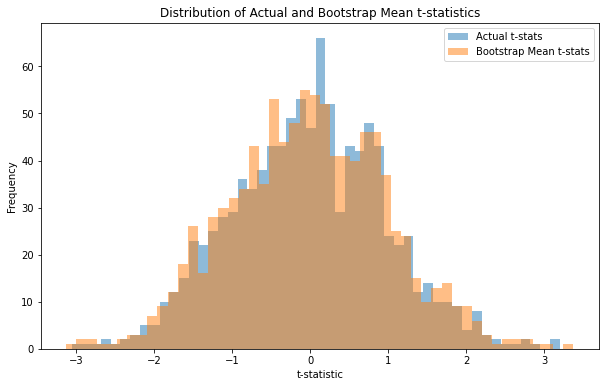

In [4]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
from scipy.stats import t
from sklearn.utils import resample
import matplotlib.pyplot as plt

# Constants
N = 1000  
T = 120  
B = 100  
mean_market_excess_return = market_return / 12  
vol_market_excess_return = volatility / np.sqrt(12)  
vol_residual = 0.1 / np.sqrt(12)  


market_excess_returns = np.random.normal(mean_market_excess_return, vol_market_excess_return, T)


fund_returns = pd.DataFrame()
residuals_df = pd.DataFrame()


for i in range(N):
    residuals = np.random.normal(0, vol_residual, T)
    fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
    residuals_df[f'Fund_{i}'] = residuals


alphas = []
betas = []
t_stats = []
for i in range(N):
    y = fund_returns[f'Fund_{i}']
    X = sm.add_constant(market_excess_returns)
    model = sm.OLS(y, X).fit()
    alphas.append(model.params[0])
    betas.append(model.params[1])
    t_stats.append(model.tvalues[0])

# Bootstrap 
bootstrap_t_stats = np.zeros((B, N))
for b in range(B):
    # Sample of 120 months
    bootstrap_sample = resample(range(T), replace=True, n_samples=T)
    # Bootstrap time-series of zero-skill excess returns
    for i in range(N):
        bootstrap_returns = betas[i] * market_excess_returns[bootstrap_sample] + residuals_df.iloc[bootstrap_sample, i]
        X_bootstrap = sm.add_constant(market_excess_returns[bootstrap_sample])
        model_bootstrap = sm.OLS(bootstrap_returns, X_bootstrap).fit()
        bootstrap_t_stats[b, i] = model_bootstrap.tvalues[0]

#  Average, 5th, and 95th percentiles of bootstrap t-stats
bootstrap_t_stats_mean = np.mean(bootstrap_t_stats, axis=0)
bootstrap_t_stats_5th = np.percentile(bootstrap_t_stats, 5, axis=0)
bootstrap_t_stats_95th = np.percentile(bootstrap_t_stats, 95, axis=0)

# Plotting
plt.figure(figsize=(10, 6), facecolor='white')
plt.hist(t_stats, bins=50, alpha=0.5, label='Actual t-stats')
plt.hist(bootstrap_t_stats_mean, bins=50, alpha=0.5, label='Bootstrap Mean t-stats')
plt.legend()
plt.xlabel('t-statistic')
plt.ylabel('Frequency')
plt.title('Distribution of Actual and Bootstrap Mean t-statistics')
plt.show()



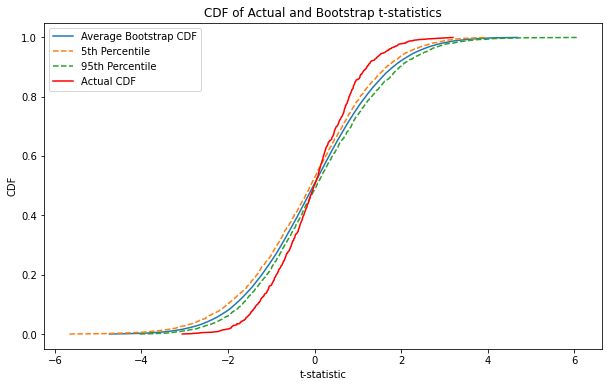

In [5]:
import numpy as np
from scipy.stats import norm


sorted_bootstrap_t_stats = np.sort(bootstrap_t_stats, axis=1)


average_t_stats = np.mean(sorted_bootstrap_t_stats, axis=0)
percentile_5th_t_stats = np.percentile(sorted_bootstrap_t_stats, 5, axis=0)
percentile_95th_t_stats = np.percentile(sorted_bootstrap_t_stats, 95, axis=0)

# CDF of actual estimated alpha t-statistics
sorted_actual_t_stats = np.sort(t_stats)
cdf_actual_t_stats = np.array(range(N)) / float(N)

# Plot the average bootstrap cumulative distribution and the CDF of actual estimated alpha t-statistics
plt.figure(figsize=(10, 6), facecolor='white')
plt.plot(average_t_stats, cdf_actual_t_stats, label='Average Bootstrap CDF')
plt.plot(percentile_5th_t_stats, cdf_actual_t_stats, linestyle='--', label='5th Percentile')
plt.plot(percentile_95th_t_stats, cdf_actual_t_stats, linestyle='--', label='95th Percentile')
plt.plot(sorted_actual_t_stats, cdf_actual_t_stats, label='Actual CDF', color='red')
plt.legend()
plt.xlabel('t-statistic')
plt.ylabel('CDF')
plt.title('CDF of Actual and Bootstrap t-statistics')
plt.show()



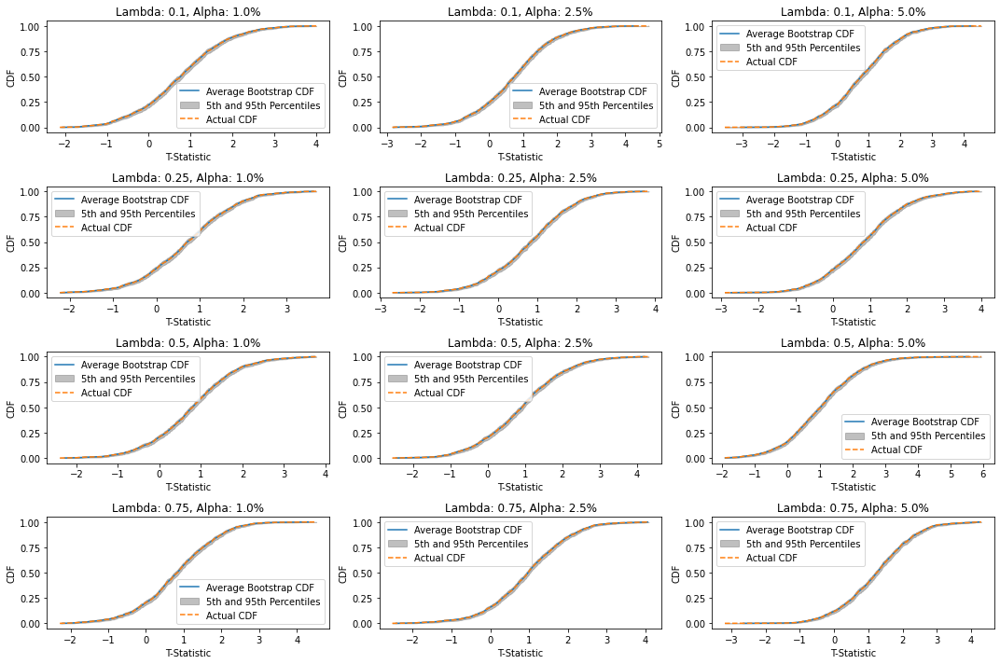

In [1]:
import numpy as np
from sklearn.utils import resample
import matplotlib.pyplot as plt
from scipy.stats import t


N = 1000  
T = 120  
num_bootstrap = 1000  
lambda_values = [0.1, 0.25, 0.5, 0.75]  
alpha_values = [0.01, 0.025, 0.05]  


E_rmkt = 0.05 / 12  
sd_rmkt = 0.2 / np.sqrt(12)  
sd_epsilon = 0.1 / np.sqrt(12)  


results = {}

# Function to simulate fund returns and perform bootstrap
def simulate_and_bootstrap(N, T, lambda_val, alpha, num_bootstrap):
    #  Market returns
    rmkt = np.random.normal(E_rmkt, sd_rmkt, (N, T))
    #  Fund returns
    fund_alphas = np.zeros(N)
    fund_alphas[:int(lambda_val * N)] = alpha / 12  
    np.random.shuffle(fund_alphas)  
    residuals = np.random.normal(0, sd_epsilon, (N, T))
    fund_returns = np.tile(fund_alphas, (T, 1)).T + rmkt + residuals
    
    # Bootstrap
    bootstrap_results = []
    for i in range(num_bootstrap):
        # Resample fund returns across fundse
        resampled_indices = np.random.randint(0, N, N)
        resampled_returns = fund_returns[resampled_indices, :]
        # t-statistics for resampled returns
        t_stats = np.mean(resampled_returns, axis=1) / np.std(resampled_returns, axis=1) * np.sqrt(T)
        sorted_t_stats = np.sort(t_stats)
        bootstrap_results.append(sorted_t_stats)
    
    bootstrap_results = np.array(bootstrap_results)
    # percentiles and average
    percentiles = np.percentile(bootstrap_results, [5, 95], axis=0)
    average = np.mean(bootstrap_results, axis=0)
    
    #  CDF of the actual estimated alpha t-statistics
    actual_t_stats = np.mean(fund_returns, axis=1) / np.std(fund_returns, axis=1) * np.sqrt(T)
    sorted_actual_t_stats = np.sort(actual_t_stats)
    cdf_actual = np.arange(1, N+1) / N
    
    return average, percentiles, sorted_actual_t_stats, cdf_actual

# Plotting function
plt.figure(figsize=(15, 10), facecolor='white')
for i, lambda_val in enumerate(lambda_values):
    for j, alpha in enumerate(alpha_values):
        average, percentiles, sorted_actual_t_stats, cdf_actual = simulate_and_bootstrap(N, T, lambda_val, alpha, num_bootstrap)
        plt.subplot(len(lambda_values), len(alpha_values), i * len(alpha_values) + j + 1)
        plt.plot(np.sort(average), cdf_actual, label='Average Bootstrap CDF')
        plt.fill_betweenx(cdf_actual, np.sort(percentiles[0]), np.sort(percentiles[1]), color='gray', alpha=0.5, label='5th and 95th Percentiles')
        plt.plot(sorted_actual_t_stats, cdf_actual, label='Actual CDF', linestyle='--')
        plt.title(f'Lambda: {lambda_val}, Alpha: {alpha*100}%')
        plt.xlabel('T-Statistic')
        plt.ylabel('CDF')
        plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
# Additional Attempts .. 
import numpy as np
import pandas as pd
import statsmodels.api as sm
from scipy.stats import t
from sklearn.utils import resample
import matplotlib.pyplot as plt


N = 1000  
T = 120  
B = 100  
mean_market_excess_return = 0.05 / 12  
vol_market_excess_return = 0.2 / np.sqrt(12)  
vol_residual = 0.1 / np.sqrt(12)  
lambdas = [0.1, 0.25, 0.5, 0.75]  
alphas_per_year = [0.01, 0.025, 0.05]  


market_excess_returns = np.random.normal(mean_market_excess_return, vol_market_excess_return, T)


results = []


for lambda_val in lambdas:
    for alpha_per_year in alphas_per_year:
        # Number of skilled funds
        num_skilled = int(N * lambda_val)
        alpha_monthly = alpha_per_year / 12  
        
        
        fund_returns = pd.DataFrame()
        residuals_df = pd.DataFrame()
        
        # Simulate fund returns and residuals, incorporating skilled funds
        for i in range(N):
            residuals = np.random.normal(0, vol_residual, T)
            if i < num_skilled:
                # Skilled fund
                fund_returns[f'Fund_{i}'] = alpha_monthly + market_excess_returns + residuals
            else:
                # Unskilled fund
                fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
            residuals_df[f'Fund_{i}'] = residuals
        
        # regression analysis 
        t_stats = []
        for i in range(N):
            y = fund_returns[f'Fund_{i}']
            X = sm.add_constant(market_excess_returns)
            model = sm.OLS(y, X).fit()
            t_stats.append(model.tvalues[0])
        
        # Bootstrap 
        bootstrap_t_stats = np.zeros((B, N))
        for b in range(B):
            # Draw a bootstrap sample
            bootstrap_sample = resample(range(T), replace=True, n_samples=T)
            for i in range(N):
                bootstrap_returns = fund_returns.iloc[bootstrap_sample, i]
                X_bootstrap = sm.add_constant(market_excess_returns[bootstrap_sample])
                model_bootstrap = sm.OLS(bootstrap_returns, X_bootstrap).fit()
                bootstrap_t_stats[b, i] = model_bootstrap.tvalues[0]
        
        # Average, 5th, and 95th percentiles of bootstrap t-stats
        bootstrap_t_stats_mean = np.mean(bootstrap_t_stats, axis=0)
        bootstrap_t_stats_5th = np.percentile(bootstrap_t_stats, 5, axis=0)
        bootstrap_t_stats_95th = np.percentile(bootstrap_t_stats, 95, axis=0)
        
        # Sort the bootstrap t-stats for each bootstrap sample
        sorted_bootstrap_t_stats = np.sort(bootstrap_t_stats, axis=1)
        
        # Calculate the average, 5th, and 95th percentiles across bootstrap samples at each rank
        average_t_stats = np.mean(sorted_bootstrap_t_stats, axis=0)
        percentile_5th_t_stats = np.percentile(sorted_bootstrap_t_stats, 5, axis=0)
        percentile_95th_t_stats = np.percentile(sorted_bootstrap_t_stats, 95, axis=0)
        
        # Calculate the CDF of actual estimated alpha t-statistics
        sorted_actual_t_stats = np.sort(t_stats)
        cdf_actual_t_stats = np.array(range(N)) / float(N)
        
        # Store results for plotting
        results.append({
            'lambda': lambda_val,
            'alpha_per_year': alpha_per_year,
            'average_t_stats': average_t_stats,
            'percentile_5th_t_stats': percentile_5th_t_stats,
            'percentile_95th_t_stats': percentile_95th_t_stats,
            'sorted_actual_t_stats': sorted_actual_t_stats,
            'cdf_actual_t_stats': cdf_actual_t_stats
        })




C:\Users\ma151\AppData\Local\Temp\ipykernel_18596\573391727.py:44: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
C:\Users\ma151\AppData\Local\Temp\ipykernel_18596\573391727.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  residuals_df[f'Fund_{i}'] = residuals
C:\Users\ma151\AppData\Local\Temp\ipykernel_18596\573391727.py:44: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performa

KeyboardInterrupt: 

In [ ]:
# To keep the execution manageable within this environment, we'll proceed to plot for one of the scenarios.
# Selecting a scenario for demonstration
selected_result = results[0]  # Example: first scenario

# Plotting for the selected scenario
plt.figure(figsize=(10, 6), facecolor='white')
plt.plot(selected_result['sorted_actual_t_stats'], selected_result['cdf_actual_t_stats'], label='Actual CDF', color='red')
plt.plot(selected_result['average_t_stats'], selected_result['cdf_actual_t_stats'], label='Average Bootstrap CDF')
plt.plot(selected_result['percentile_5th_t_stats'], selected_result['cdf_actual_t_stats'], linestyle='--', label='5th Percentile')
plt.plot(selected_result['percentile_95th_t_stats'], selected_result['cdf_actual_t_stats'], linestyle='--', label='95th Percentile')
plt.legend()
plt.xlabel('t-statistic')
plt.ylabel('CDF')
plt.title(f'CDF of Actual and Bootstrap t-statistics (Lambda={selected_result["lambda"]}, Alpha={selected_result["alpha_per_year"]*100}%)')
plt.show()


# Function to calculate CDF from data
def calculate_cdf(data):
    sorted_data = np.sort(data)
    cdf = np.arange(1, len(sorted_data) + 1) / len(sorted_data)
    return sorted_data, cdf

# Plotting for one of the scenarios for demonstration
fig, axs = plt.subplots(len(lambdas), len(alphas_per_year), figsize=(15, 10), sharex=True, sharey=True)

for i, lambda_val in enumerate(lambdas):
    for j, alpha_per_year in enumerate(alphas_per_year):
        idx = i * len(alphas_per_year) + j
        result = results[idx]
        
        # Calculate the CDF of actual and bootstrap t-statistics
        actual_sorted, actual_cdf = calculate_cdf(result['sorted_actual_t_stats'])
        bootstrap_sorted, bootstrap_cdf = calculate_cdf(result['average_t_stats'])

        axs[i, j].plot(actual_sorted, actual_cdf, label='Actual CDF', color='red')
        axs[i, j].plot(bootstrap_sorted, bootstrap_cdf, label='Bootstrap CDF', color='blue')
        axs[i, j].fill_between(bootstrap_sorted, calculate_cdf(result['percentile_5th_t_stats'])[1], calculate_cdf(result['percentile_95th_t_stats'])[1], color='blue', alpha=0.2)
        axs[i, j].set_title(f'Lambda={lambda_val}, Alpha={alpha_per_year*100}%')
        axs[i, j].set_xlim([-5, 5])
        
        if i == len(lambdas) - 1:
            axs[i, j].set_xlabel('t-statistic')
        if j == 0:
            axs[i, j].set_ylabel('CDF')

# Adding legend to the last subplot for clarity
handles, labels = axs[-1, -1].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right')

plt.tight_layout()
plt.show()
